In [1]:
import torch
from training.summary.datamodule import SummaryDataset
from transformers import ViTImageProcessor
from tqdm import tqdm
import matplotlib.pyplot as plt
import cv2
import seaborn as sns
import numpy as np
from moviepy.editor import VideoFileClip, concatenate_videoclips

from v2021 import SummaryModel

<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [2]:
preprocessor = ViTImageProcessor.from_pretrained(
    "google/vit-base-patch16-224", size=224, device='cuda'
)

In [58]:
SAMPLE_EVERY_SEC = 2

video_path = 'videos/news2.mp4'

cap = cv2.VideoCapture(video_path)

n_frames = cap.get(cv2.CAP_PROP_FRAME_COUNT)
fps = cap.get(cv2.CAP_PROP_FPS)

video_len = n_frames / fps

print(f'Video length {video_len:.2f} seconds!')

frames = []
last_collected = -1

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    timestamp = cap.get(cv2.CAP_PROP_POS_MSEC)
    second = timestamp // 1000

    if second % SAMPLE_EVERY_SEC == 0 and second != last_collected:
        last_collected = second
        frames.append(frame)

features = preprocessor(images=frames, return_tensors="pt")["pixel_values"]

print(features.shape)

Video length 1346.01 seconds!
torch.Size([674, 3, 224, 224])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


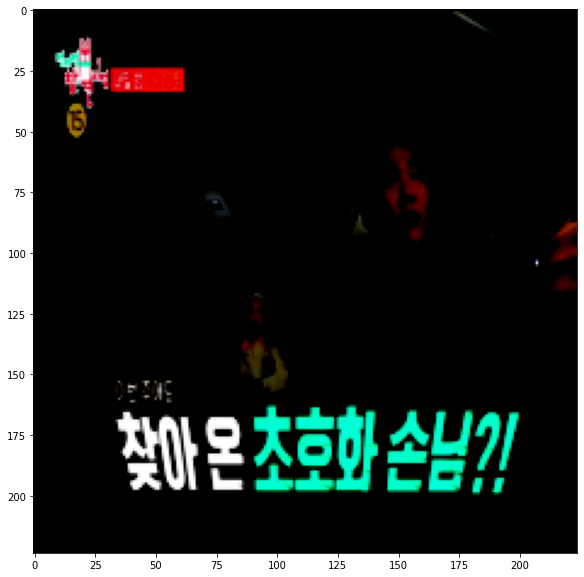

In [59]:
plt.figure(figsize=(10, 10))
plt.imshow(features[0].numpy().transpose(1, 2, 0)[:, :, ::-1])

In [19]:
model = SummaryModel.load_from_checkpoint('summary.ckpt')
model.to('cuda')
model.eval()

SummaryModel(
  (vit): ViTModel(
    (embeddings): ViTEmbeddings(
      (patch_embeddings): ViTPatchEmbeddings(
        (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
      )
      (dropout): Dropout(p=0.0, inplace=False)
    )
    (encoder): ViTEncoder(
      (layer): ModuleList(
        (0): ViTLayer(
          (attention): ViTAttention(
            (attention): ViTSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.0, inplace=False)
            )
            (output): ViTSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.0, inplace=False)
            )
          )
          (intermediate): ViTIntermediate(
            (dense): Linear(in_features=768, out_features=3072

100%|██████████| 674/674 [00:07<00:00, 95.70it/s]


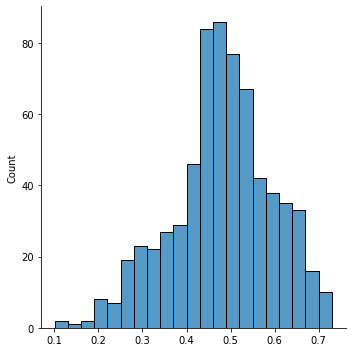

In [60]:
features = features.to('cuda')

y_pred = []

for frame in tqdm(features):
    y_p = model(frame.unsqueeze(0))
    y_p = torch.sigmoid(y_p)

    y_pred.append(y_p.cpu().detach().numpy().squeeze())

y_pred = np.array(y_pred)

sns.displot(y_pred)

In [64]:
THRESHOLD = 0.67

total_secs = 0

for i, y_p in enumerate(y_pred):
    if y_p >= THRESHOLD:
        print(i * SAMPLE_EVERY_SEC)
        total_secs += SAMPLE_EVERY_SEC

total_secs

342
344
372
562
680
682
684
686
688
690
798
800
802
816
824
836
906
908
910
912
914
998
1000
1002
1004
1006


52

In [65]:
clip = VideoFileClip(video_path)

subclips = []

for i, y_p in enumerate(y_pred):
    sec = i * SAMPLE_EVERY_SEC

    if y_p >= THRESHOLD:
        subclip = clip.subclip(sec, sec + SAMPLE_EVERY_SEC)
        subclips.append(subclip)

result = concatenate_videoclips(subclips)

result.write_videofile("videos/result.mp4")

result.ipython_display(width=640, maxduration=240)

t:  85%|████████▍ | 7866/9270 [22:20<00:05, 262.21it/s, now=None]

Moviepy - Building video videos/result.mp4.
MoviePy - Writing audio in resultTEMP_MPY_wvf_snd.mp3


t:  85%|████████▍ | 7866/9270 [22:21<00:05, 262.21it/s, now=None]

MoviePy - Done.
Moviepy - Writing video videos/result.mp4



t:  85%|████████▍ | 7866/9270 [22:28<00:05, 262.21it/s, now=None]

Moviepy - Done !
Moviepy - video ready videos/result.mp4
Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


t:  85%|████████▍ | 7866/9270 [22:29<00:05, 262.21it/s, now=None]

MoviePy - Done.
Moviepy - Writing video __temp__.mp4



t:  85%|████████▍ | 7866/9270 [22:35<00:05, 262.21it/s, now=None]

Moviepy - Done !
Moviepy - video ready __temp__.mp4
